# Neural Network Notebook

Implementation of a Feed Forward Neural Network for MultiClass Classification from scratch

#### Key points from ISL chapter 10.1/10.2
- A neural network takes an input vector of p variables X = (X1,X2, . . . ,Xp)
- Each node calculates a linear combination of the weights, x_1-->x_n values + the bias term and we call this calculation z

- Each node has an activation function. Here we can use the sigmoid function known from Logistic Regression, but the best and most commonly used is the ReLu function.
- The activation function takes in z (linear combination) and spits out a value h.
- h is the output of our activation function that will be used to calculate a new z value in the upcoming layer.
- In the output layer we have the number of nodes equal to the number of classes we want to predict. 


## Hyperparamters we can change

- Number of Layers and Nodes (structure)
- Epochs 
- Learning Rate 
- Batches
- Activation Function
- Weight Initialisation
- Biases

### Imports:

In [129]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from tqdm import tqdm
from tqdm import tqdm_notebook
from sklearn import preprocessing
from sklearn.utils import shuffle
import math
from sklearn.decomposition import PCA 

#### Test Data set - Sklearn Iris Data set 

In [130]:
# ###### IRIS #######
# from sklearn import datasets
# iris = datasets.load_iris()
# X_raw = iris.data
# y = iris.target
# X = preprocessing.normalize(X_raw)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=69)


### Final Data Preprocessing

In [131]:
# training sets
X_train = pd.read_csv('data/X_train.csv')
X_train_norm = pd.read_csv('data/X_train_normalised.csv')
X_train_synth = pd.read_csv('data/X_train_synth.csv')

X_train = X_train.to_numpy()
X_train_norm = X_train_norm.to_numpy()
X_train_synth = X_train_synth.to_numpy()

y_train = pd.read_csv('data/y_train.csv')
y_train_synth = pd.read_csv('data/y_train_synth.csv')
y_train = y_train.to_numpy()
y_train_synth = y_train_synth.to_numpy()
y_train = y_train.flatten()
y_train_synth = y_train_synth.flatten()


# testing sets
X_test = pd.read_csv('data/X_test.csv')
X_test_norm = pd.read_csv('data/X_test_normalised.csv')

X_test = X_test.to_numpy()
X_test_norm = X_test_norm.to_numpy()

y_test = pd.read_csv('data/y_test.csv')
y_test = y_test.to_numpy()
y_test = y_test.flatten()


In [132]:
### PCA

pca = PCA(n_components=6)
pca_youngboy = pca.fit(X_train_norm)
X_train_pca = pca_youngboy.transform(X_train_norm)
X_test_pca = pca_youngboy.transform(X_test_norm)

In [133]:
class NN: 

    def __init__(self,hidden_layers, nodes_in_hidden_layers, verbose:bool):
        self.structure = [nodes_in_hidden_layers] * hidden_layers
        self.verbose = verbose

        # print flags for debugging 
        self.forprop_print0 = True 
        self.forprop_print1 = True 
        self.backprop_print = True 

    def activation_function(self,z,choice:str): # z is a 2d vector
        if choice == 'relu':
            a = []
            for _ in z:
                rel = [max(0.0,val) for val in _]
                a.append(rel)   
            return np.atleast_2d(a) 
        if choice == 'leakyrelu':
            a = []
            for _ in z:
                rel = [max(0.01*val,val) for val in _]
                a.append(rel)   
            return np.atleast_2d(a) 
        if choice == 'sigmoid':
            return 1.0/(1.0+ np.exp(-z))
        if choice == 'softmax':
            a = []
            for _ in z:
                e = np.exp(z[0])
                a.append(e/e.sum())   
            return np.atleast_2d(a) 
            
        
    def deriv_activation(self,a, choice): # a is a  2d vector 
        if choice == 'relu':
            deriv = []
            for _ in a:
                rel = [1 if val >= 0 else 0 for val in _]
                deriv.append(rel)   
            return np.atleast_2d(deriv) 
        if choice == 'leakyrelu':
            deriv = []
            for _ in a:
                rel = [1 if val >= 0 else 0.001 for val in _]
                deriv.append(rel)   
            return np.atleast_2d(deriv)  
        if choice == 'sigmoid':
            ones = np.ones(len(a))
            return (a*(ones-a))
        if choice == 'softmax':
            return np.diag(a[0]) - (a * a.T) 

    def loss_function(self,p,y, choice): # takes p:vector , y:vector of ohe
        #assert np.shape(p) == np.shape(y),f'p {np.shape(p)} and y {np.shape(y)} must be same dimention '
        loss = 0
        if choice == 'ce':               # use ce if softmax
            for index in range(len(p)):
                tru = np.argmax(y[index])
                loss += -np.log(p[index][tru]) 
            return loss
        if choice == 'mse':
            return #mse

    def one_hot_encode(self,y):
        vector = np.zeros(self.classes)     # a 0 vector with 1 in the position of the true class
        vector[y] = 1
        return vector                           # (1,9)

    def map_ys(self,y):
        y_map = {1:0,2:1,3:2,5:3,6:4,7:5}
        mapped = []
        for c in y:
            mapped.append(y_map[c])
        return mapped

    def unmap_ys(p):
        p_unmap = {0:1,1:2,2:3,3:5,4:6,5:7}
        for index, c in enumerate(p):
            p[index] = p_unmap[c]
        return p
    
    def load_train(self, X_train, y_train, bias:bool, initialise:bool):
        self.classes = len(np.unique(y_train))
        self.X_train = X_train
        y_train = self.map_ys(y_train)
        self.y_train = [self.one_hot_encode(y) for y in y_train] #self.map_ys(y_train)
        self.structure.insert(0,self.X_train.shape[1])
        self.structure.append(self.classes)            # structure = number of nodes in each layer [features, hidden,..., hidden, outputs]
        

        if initialise:                                 # Initialise weights
            self.neurons = [None]*len(self.structure)  # Stores A values from most recent forward prop
            self.weights = []                          # Stores all weights
            for layer in range(len(self.structure)-1): 
                # 2d array with (9,n) for layer 1
                w = (2 * (np.random.random([self.structure[layer],self.structure[layer+1]]))) - 1
                self.weights.append(w) 

        ##############################################
        if self.verbose: print(f'INITIAL: training data: X {np.shape(self.X_train)} y {np.shape(self.y_train)}, structure: {self.structure}, weights {[np.shape(w) for w in self.weights]}')
        ##############################################

    def fit(self, alpha, epochs,batch_size):
        prev_loss = 1000000000000
        self.losses = []
        self.accuracies = []
        
        for epoch in range(epochs):
            self.X_train, self.y_train= shuffle(self.X_train, self.y_train)
            
            loss = 0 # cLosst
            n_c = 0 # num correct predictions
            n_w = 0 # num wrong predictions

            batch_start = 0
            batch_num = 0
            batch_end = batch_start + batch_size
            
            while batch_start < self.X_train.shape[0]:            # iterate through a the dataset in batches
                
                # set x and y to be propagated 
                x = self.X_train[batch_start:batch_end]         # (10,4)
                y = self.y_train[batch_start:batch_end]         # list of ohe vectors

                # single forward pass for one data point
                self.forward_propagate(x)
                
                # prediction vector is last layer of 'a's
                p = self.neurons[-1]

                # increment the loss of the epoch
                loss += self.loss_function(p,y,'ce')
                
                # make a prediction in order to calculate accuracy of epoch
                for index in range(len(p)):
                    if np.argmax(p[index]) == np.argmax(y[index]):
                        n_c += 1
                    else: n_w += 1 

                # deltas reveal how much to update weights by
                deltas = self.back_propagate(y)
                for i in range(len(self.weights)): # 0,1,2                    
                    self.weights[i] -= (alpha * deltas[i])                                                            # print(f'delta {i} {deltas[i]} {np.shape(deltas[i])}')   # print(f'weights {i} {self.weights[i]} {np.shape(self.weights[i])}')      # print(f'weights {i} {self.weights[i]} {np.shape(self.weights[i])}')
                    
                ##################################################################################
                if self.verbose and batch_size == 5: print(f'BATCH 5: inputs = {np.shape(x)}, y = {y}{np.shape(y)}, p = {p}{np.shape(p)}, deltas = {np.shape(deltas)}')
                ##################################################################################

                batch_start += batch_size
                batch_end += batch_size
                batch_num += 1
                
                if batch_end > self.X_train.shape[0]: batch_end = self.X_train.shape[0]

            # give overview and update loss + accuracy 
            loss = loss/self.X_train.shape[0]               #normalise loss to X size 
            accuracy = n_c/self.X_train.shape[0]
            
            ########################################################################################
            if self.verbose: print(f'Epoch {epoch}: Loss = {loss}, Accuracy = {n_c}/{n_c+n_w} {n_w} {accuracy}, {np.shape(self.neurons[-1])}, {np.shape(y)}')
            ########################################################################################

            self.losses.append(loss)
            self.accuracies.append(accuracy)
            
            # early stopping 
            if epoch > 200:
                if loss > (prev_loss*1.1) or math.isnan(loss):
                    break   
                
            prev_loss = loss    
        
        

    def forward_propagate(self, x):
        # store input features 
        self.neurons[0] = x  # (10,4)
         
        # propagate each layer in the network
        for layer in range(len(self.structure)-1): # 0,1,2
            
            # calculate 'z' as linear combination of previous 'z'/features and weights
            z = self.neurons[layer] @ self.weights[layer]    #(10,4) @ (4,2) = (10,2)
            
            # compute 'a' and store with alternative activation for last layer
            if layer != len(self.structure)-2: 
                a = self.activation_function(z,'relu')
            else:
                a = self.activation_function(z,'softmax')
            self.neurons[layer+1] = a 

            #######################################################
            if self.verbose and self.forprop_print0:
                print(f'FP First Layer z: {np.shape(self.neurons[layer])} @ {np.shape(self.weights[layer])} = {np.shape(z)}, a: {np.shape(a)}')
                self.forprop_print0 = False
            #######################################################
        if self.verbose and self.forprop_print1:
            print(f'FP Last Layer z: {np.shape(self.neurons[len(self.structure)-2])} @ {np.shape(self.weights[len(self.structure)-2])} = {np.shape(z)}, a: {np.shape(a)}')
            self.forprop_print1 = False
        #######################################################


    def back_propagate(self, y):
        
        # compute p, y and last layer delta
        p = self.neurons[-1]
        errors = [p - y] 
        deltas = [self.neurons[-2].T @ (p - y)] 
        
        # shortcut for computing each layer's delta without needing Jacobian Matrix Multiplication -- output->input        
        for l in range(len(self.neurons) - 2, 0, -1): #2,1,2,1,2,1
            # gradient of previous layer deltas with respect to Loss and current layer A
            dXdA = np.atleast_2d(errors[-1])  #(10,3)
            
            # current layer delta
            dAdW = dXdA @ self.weights[l].T                    #(10,2)          
            dZ = self.deriv_activation(dAdW,'relu')       #(10,2)            
            dLdW = dZ * dAdW                                   #(10,2)                            

            # append deltas to be used by next layer and for weight update
            errors.append(dLdW)
            deltas.append(self.neurons[l-1].T @ dLdW)                       

            #######################################################
            if self.verbose and self.backprop_print:
                print(f'BP: p - y = {np.shape(p-y)}, dXdA {np.shape(dXdA)}, dAdW {np.shape(dAdW)}, dZ {np.shape(dZ)}, dLdW {np.shape(dLdW)}')
        self.backprop_print = False 
            #######################################################

        # return gradients needed for weight updates in order from layer input->output
        deltas.reverse()
        return deltas
        
    def predict(self,X,Y):
        Y = self.map_ys(Y)
        n_c = 0 # number of correct predictions
        c = 0   # total loss

        for index, datapoint in enumerate(X):
            
            x = np.atleast_2d(datapoint)      # features (1,4)
            y = Y[index]                      # single ohe vector (1,3)
            y_ohe = self.one_hot_encode(y)
            
            # forward propagate
            self.forward_propagate(x)
            
            # update loss
            p = self.neurons[-1]

            loss = self.loss_function(p,y_ohe,'ce')
            c += loss
            
            if np.argmax(p)== y:
                n_c+=1
            
            #print(f'Datapoint {index}: class: {y}, pred = {np.argmax(p)}, loss = {loss}, confidence = {self.neurons[-1]}')
        c = c/len(X)    
        accuracy = n_c/len(X)
        print(f'Total Test Loss: {c}, Accuracy: {accuracy}')

    def plot(self,l,n,a,b,d):
        fig, ax = plt.subplots(1,2,figsize = (10,5))
        
        ax[0] = ax[0] 
        ax[1] = ax[1]
        
        ax[0].plot(range(len(self.losses)),self.losses)
        ax[0].set_title(f'Training Loss Plot on {d} with alpha: {a}')
        ax[0].set_xlabel('epochs')
        ax[0].set_ylabel('loss')

        ax[1].plot(range(len(self.accuracies)),self.accuracies)
        ax[1].set_title(f'Training Accuracy Plot ')
        ax[1].set_xlabel('epochs')
        ax[1].set_ylabel('accuracy')


Total Test Loss: 7.97350671763731, Accuracy: 0.7384615384615385


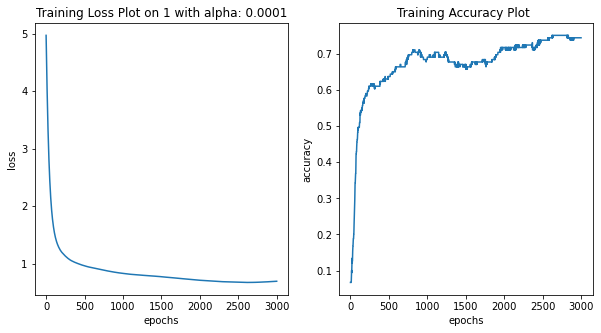

In [137]:
np.random.seed(9)

Xs = [X_train_synth, X_train_norm, X_train_pca]
ys = [y_train_synth, y_train, y_train]
a = 0.0001
l = 1
n = 25
b = 1
d = 1

Model = NN(l,n,verbose=False)
Model.load_train(Xs[d], ys[d], bias = False, initialise = True)
Model.fit(alpha = a, epochs = 3000, batch_size=b)
Model.plot(l,n,a,b,d)

Model.predict(X_test_norm,y_test)



In [ ]:
Model.predict(X_test_norm,y_test)

Total Test Loss: 5.038122879048402, Accuracy: 0.7076923076923077


<ipython-input-133-338367a9a763>:30: RuntimeWarning: overflow encountered in exp
  e = np.exp(z[0])
<ipython-input-133-338367a9a763>:31: RuntimeWarning: invalid value encountered in true_divide
  a.append(e/e.sum())


Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231


<ipython-input-133-338367a9a763>:60: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(p[index][tru])


Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: 8.775554885101313, Accuracy: 0.4461538461538462
Total Test Loss: 6.195713292163327, Accuracy: 0.676923076923077
Total Test Loss: 4.923938208554552, Accuracy: 0.6923076923076923


<ipython-input-133-338367a9a763>:264: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,2,figsize = (10,5))


Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: nan, Accuracy: 0.3230769230769231
Total Test Loss: 2.5745204579848076, Accuracy: 0.38461538461538464
Total Test Loss: 2.430387458906253, Accuracy: 0.5692307692307692
Total Test Loss: 1.227008240347093, Accuracy: 0.38461538461538464
Total Test Loss: 9.18826678381058, Ac

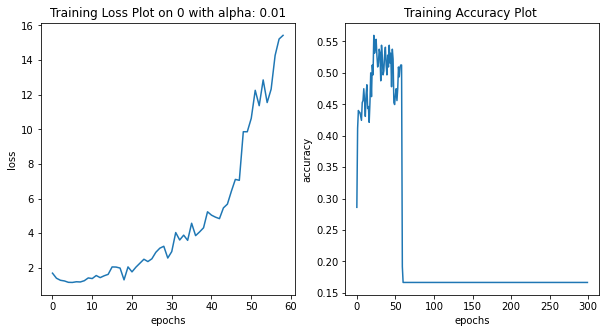

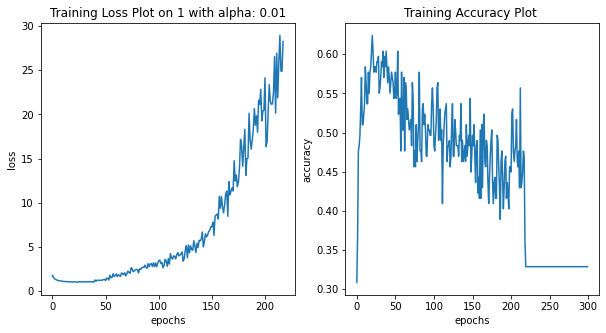

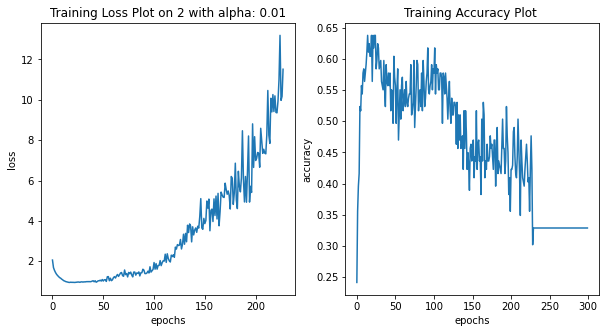

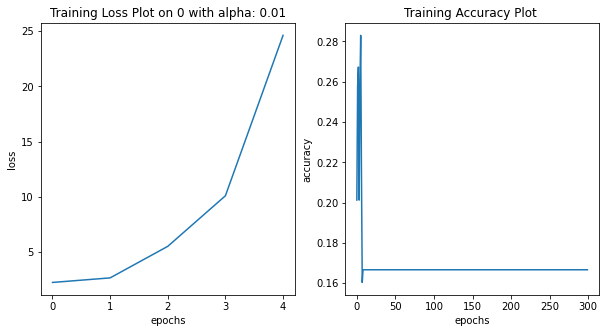

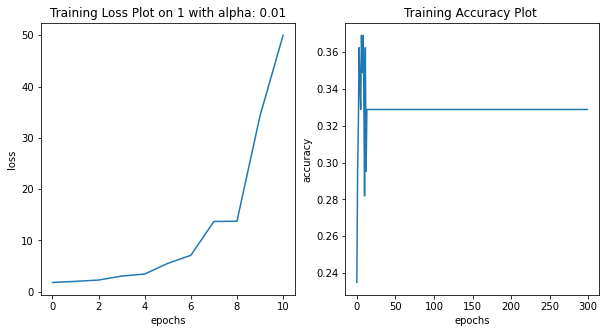

...

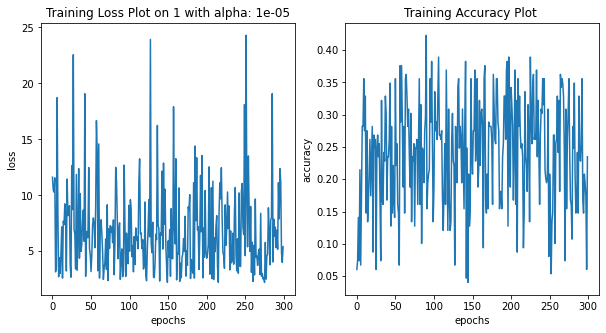

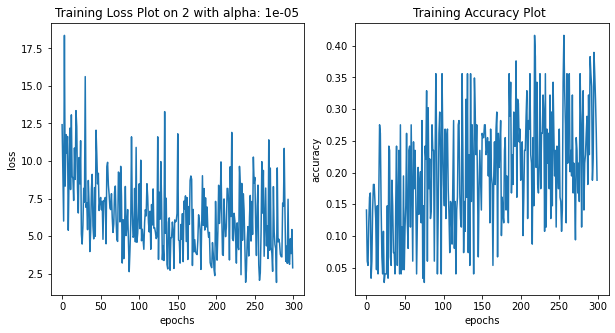

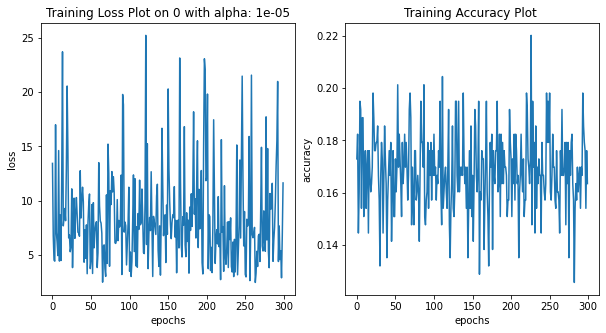

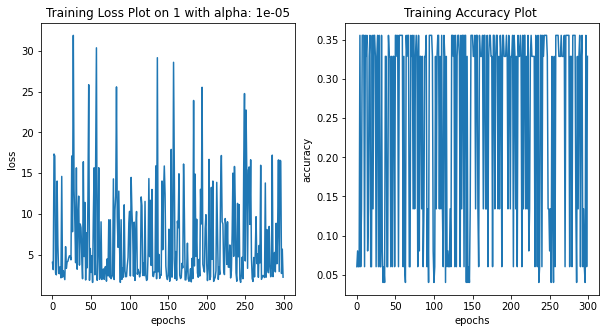

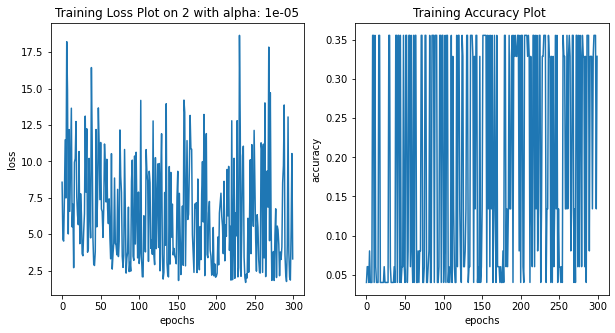

In [138]:
ls =[1,2]
ns =[5,15,25,30]
alphas = [0.01,0.001,0.0001,0.00001]
batches = [1,3,6,10,50,149]
for l in ls:
    for n in ns:
        for a in alphas:
            for b in batches:
                for d in range(len(Xs)):
                    np.random.seed(9)
                    Model = NN(l,n,verbose=False)
                    Model.load_train(Xs[d], ys[d], bias = False, initialise = True)
                    Model.fit(alpha = a, epochs = 300, batch_size=b)
                    if d == 2: Model.predict(X_test_pca,y_test)
                    else: Model.predict(X_test_norm,y_test)
                    Model.plot(l,n,a,b,d)